Imports

## Code

In [6]:
%run landsat.py

Settings

In [2]:
pd.options.display.max_columns = 100

Google Earth Engine

In [ ]:
COLAB_AUTH_FLOW_CLOUD_PROJECT_FOR_API_CALLS = "earth-engine-landsat"

import ee
import google
import os

if COLAB_AUTH_FLOW_CLOUD_PROJECT_FOR_API_CALLS is None:
    print("Authenticating using Notebook auth...")
    if os.path.exists(ee.oauth.get_credentials_path()) is False:
        ee.Authenticate()
    else:
        print('\N{check mark} '
              'Previously created authentication credentials were found.')
    ee.Initialize()
else:
    print('Authenticating using Colab auth...')
  # Authenticate to populate Application Default Credentials in the Colab VM.
    google.auth.authenticate_user()
  # Create credentials needed for accessing Earth Engine.
    credentials, auth_project_id = google.auth.default()
  # Initialize Earth Engine.
    ee.Initialize(credentials, project=COLAB_AUTH_FLOW_CLOUD_PROJECT_FOR_API_CALLS)
print('\N{check mark} Successfully initialized!')

In [ ]:
ee.Initialize(project="earth-engine-landsat", credentials=)

In [65]:
import geemap.core as geemap
dataset = ee.ImageCollection("LANDSAT/LC08/C02/T1").filterDate(
    '2017-01-01', '2017-12-31'
)
bands = dataset.select(["B4", "B5", "B10"])
bands_vis = {
    'min': 0.0,
    'max': 0.4,
}
m = geemap.Map()
m.set_center(6.746, 46.529, 6)
m.add_layer(bands, bands_vis, "Data")
m

ProxyError: HTTPSConnectionPool(host='oauth2.googleapis.com', port=443): Max retries exceeded with url: /token (Caused by ProxyError('Unable to connect to proxy', NewConnectionError('<urllib3.connection.HTTPSConnection object at 0x0000024DBD3FF750>: Failed to establish a new connection: [WinError 10061] No connection could be made because the target machine actively refused it')))

In [61]:
dataset = ee.ImageCollection('LC08/L1TP/014032/20140807/20200911/02/T1').filterDate(
    '2017-01-01', '2017-12-31'
)
true_color_432 = dataset.select(['B4', 'B3', 'B2'])
true_color_432_vis = {
    'min': 0.0,
    'max': 0.4,
}
geemap.set_proxy(port=443)
m = geemap.Map()
m.set_center(6.746, 46.529, 6)
m.add_layer(true_color_432, true_color_432_vis, 'True Color (432)')
m

HTTPSConnectionPool(host='earthengine.google.com', port=443): Max retries exceeded with url: / (Caused by ProxyError('Unable to connect to proxy', NewConnectionError('<urllib3.connection.HTTPSConnection object at 0x0000024DC0CB7ED0>: Failed to establish a new connection: [WinError 10061] No connection could be made because the target machine actively refused it')))


ProxyError: HTTPSConnectionPool(host='oauth2.googleapis.com', port=443): Max retries exceeded with url: /token (Caused by ProxyError('Unable to connect to proxy', NewConnectionError('<urllib3.connection.HTTPSConnection object at 0x0000024DBD19D790>: Failed to establish a new connection: [WinError 10061] No connection could be made because the target machine actively refused it')))

## Data
### Metadata

In [8]:
file = "phl_landsat_data.zip!landsat_ot_c2_l2_649cf5448df991d7.shp" 
phl = gpd.read_file(file).to_crs(epsg=2272)

In [21]:
phl

,Landsat Pr,Landsat _1,Landsat Sc,Date Acqui,Collection,Collecti_1,WRS Path,WRS Row,Target WRS,Target W_1,Nadir/Off,Roll Angle,Date Produ,Date Pro_1,Start Time,Stop Time,Station Id,Day/Night,Land Cloud,Scene Clou,Ground Con,Ground C_1,Geometric,Geometri_1,Geometri_2,Processing,Sun Elevat,Sun Azimut,TIRS SSM M,Data Type,Sensor Ide,Satellite,Product Ma,UTM Zone,Datum,Ellipsoid,Scene Cent,Scene Ce_1,Corner Upp,Corner U_1,Corner U_2,Corner U_3,Corner Low,Corner L_1,Corner L_2,Corner L_3,Scene Ce_2,Scene Ce_3,Corner U_4,Corner U_5,Corner U_6,Corner U_7,Corner L_4,Corner L_5,Corner L_6,Corner L_7,geometry
0,LC08_L2SP_014032_20130320_20200913_02_T1,LC08_L1TP_014032_20130320_20200913_02_T1,LC80140322013079LGN04,2013-03-20,T1,2,014,032,014,032,NADIR,0.000,2020-09-13,2020-09-13,2013-03-20,2013-03-20,LGN,DAY,18.14,16.52,762,5,5.477,3.834,3.911,LPGS_15.3.1c,45.23960402,148.62193900,ACTUAL,OLI_TIRS_L2SP,OLI_TIRS,8,UTM,18,WGS84,WGS84,"40&deg;19'57.54""N","74&deg;52'11.89""W","41&deg;19'31.87""N","76&deg;12'37.66""W","41&deg;19'20.93""N","73&deg;31'44.83""W","39&deg;19'04.01""N","76&deg;10'30.43""W","39&deg;18'53.82""N","73&deg;34'19.42""W",40.33265,-74.86997,41.32552,-76.21046,41.32248,-73.52912,39.31778,-76.17512,39.31495,-73.57206,"POLYGON ((2410370.694 144249.209, 2533989.519 ..."
1,LC08_L2SP_015032_20130407_20200912_02_T1,LC08_L1TP_015032_20130407_20200912_02_T1,LC80150322013097LGN05,2013-04-07,T1,2,015,032,015,032,NADIR,0.000,2020-09-12,2020-09-12,2013-04-07,2013-04-07,LGN,DAY,7.20,7.15,819,5,5.711,4.000,4.077,LPGS_15.3.1c,52.22768822,146.38349448,ACTUAL,OLI_TIRS_L2SP,OLI_TIRS,8,UTM,18,WGS84,WGS84,"40&deg;19'57.65""N","75&deg;50'37""W","41&deg;19'17.51""N","77&deg;12'24.62""W","41&deg;20'29.90""N","74&deg;30'27.25""W","39&deg;18'04.68""N","77&deg;08'31.24""W","39&deg;19'12.11""N","74&deg;31'19.34""W",40.33268,-75.84361,41.32153,-77.20684,41.34164,-74.50757,39.30130,-77.14201,39.32003,-74.52204,"POLYGON ((2136902.105 140653.329, 2267093.486 ..."
2,LC08_L2SP_014032_20130414_20200913_02_T1,LC08_L1TP_014032_20130414_20200913_02_T1,LC80140322013104LGN03,2013-04-14,T1,2,014,032,014,032,NADIR,0.000,2020-09-13,2020-09-13,2013-04-14,2013-04-14,LGN,DAY,14.34,13.91,704,5,5.866,4.071,4.224,LPGS_15.3.1c,54.75499656,145.25556820,ACTUAL,OLI_TIRS_L2SP,OLI_TIRS,8,UTM,18,WGS84,WGS84,"40&deg;19'58.66""N","74&deg;51'47.45""W","41&deg;19'31.04""N","76&deg;13'55.06""W","41&deg;19'19.27""N","73&deg;29'35.84""W","39&deg;19'03.25""N","76&deg;11'45.56""W","39&deg;18'52.27""N","73&deg;32'14.17""W",40.33296,-74.86318,41.32529,-76.23196,41.32202,-73.49329,39.31757,-76.19599,39.31452,-73.53727,"POLYGON ((2404623.327 148363.040, 2527384.940 ..."
3,LC08_L2SP_014032_20130430_20200912_02_T1,LC08_L1TP_014032_20130430_20200912_02_T1,LC80140322013120LGN02,2013-04-30,T1,2,014,032,014,032,NADIR,0.000,2020-09-12,2020-09-12,2013-04-30,2013-04-30,LGN,DAY,39.51,40.06,579,5,5.219,3.766,3.613,LPGS_15.3.1c,59.82313594,141.88972924,ACTUAL,OLI_TIRS_L2SP,OLI_TIRS,8,UTM,18,WGS84,WGS84,"40&deg;19'57.65""N","74&deg;51'26.42""W","41&deg;19'31.30""N","76&deg;13'29.28""W","41&deg;19'18.91""N","73&deg;29'10.03""W","39&deg;19'03.50""N","76&deg;11'20.51""W","39&deg;18'51.95""N","73&deg;31'49.15""W",40.33268,-74.85734,41.32536,-76.22480,41.32192,-73.48612,39.31764,-76.18903,39.31443,-73.53032,"POLYGON ((2406223.988 148205.387, 2528653.600 ..."
4,LC08_L2SP_014032_20130516_20200912_02_T1,LC08_L1TP_014032_20130516_20200912_02_T1,LC80140322013136LGN03,2013-05-16,T1,2,014,032,014,032,NADIR,0.000,2020-09-12,2020-09-12,2013-05-16,2013-05-16,LGN,DAY,68.23,69.93,622,5,5.562,3.927,3.939,LPGS_15.3.1c,63.59596045,137.58641589,ACTUAL,OLI_TIRS_L2SP,OLI_TIRS,8,UTM,18,WGS84,WGS84,"40&deg;19'57.47""N","74&deg;53'55""W","41&deg;19'29.64""N","76&deg;16'04.08""W","41&deg;19'20.93""N","73&deg;31'44.83""W","39&deg;19'01.92""N","76&deg;13'50.84""W","39&deg;18'53.82""N","73&deg;34'19.42""W",40.33263,-74.89861,41.32490,-76.26780,41.32248,-73.52912,39.31720,-76.23079,39.31495,-73.57206,"POLYGON ((2394580.682 148017.482

### Landsat 8: Jun 2013-2022
Notes from https://musa-550-fall-2021.github.io/slides/lecture-4B.html

In [4]:
import rasterio as rio
from rasterio.mask import mask

In [5]:
from rasterstats import zonal_stats

In [6]:
import xarray as xr
import rioxarray as rxr

#### City Limits

In [3]:
url = "http://data.phl.opendata.arcgis.com/datasets/405ec3da942d4e20869d4e1449a2be48_0.geojson"
city_limits = gpd.read_file(url).to_crs(epsg=32618)

In [4]:
city_limits

,OBJECTID,Shape__Area,Shape__Length,geometry
0,1,3.970706e+09,394751.12047,"POLYGON ((498724.960 4443066.927, 498759.458 4..."


In [30]:
phl_census = gpd.read_file("Data/phl_census_block_groups_2010.geojson")
phl_census_32618 = phl_census.to_crs(32618)
len(phl_census_32618)

1336

In [5]:
census_blocks = "https://opendata.arcgis.com/datasets/2f982bada233478ea0100528227febce_0.geojson"
phl_census_blocks = gpd.read_file(census_blocks).dissolve(by="NAMELSAD10").to_crs(epsg=32618)

In [10]:
phl_census_blocks

,geometry,OBJECTID,STATEFP10,COUNTYFP10,TRACTCE10,BLKGRPCE10,GEOID10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,Shape__Area,Shape__Length
NAMELSAD10,,,,,,,,,,,,,,,
Block Group 1,"MULTIPOLYGON (((481497.186 4414012.544, 481468...",1,42,101,010800,1,421010108001,G5030,S,161887,0,+39.9687580,-075.1997251,1.742508e+06,8200.327170
Block Group 2,"MULTIPOLYGON (((479123.117 4417605.720, 479046...",2,42,101,010800,2,421010108002,G5030,S,103778,0,+39.9665475,-075.2004455,1.117026e+06,4364.980144
Block Group 3,"MULTIPOLYGON (((479032.469 4417029.378, 478945...",6,42,101,011000,3,421010110003,G5030,S,111388,0,+39.9743352,-075.2073541,1.198951e+06,5524.835208
Block Group 4,"MULTIPOLYGON (((479284.630 4417971.435, 479259...",7,42,101,011100,4,421010111004,G5030,S,147334,0,+39.9754452,-075.2281518,1.585865e+06,5762.100861
Block Group 5,"MULTIPOLYGON (((479496.384 4418559.995, 479478...",17,42,101,011200,5,421010112005,G5030,S,75721,0,+39.9746670,-075.2370319,8.150485e+05,3723.621106
Block Group 6,"MULTIPOLYGON (((480854.456 4419007.548, 480844...",14,42,101,011200,6,421010112006,G5030,S,64273,0,+39.9750282,-075.2347353,6.918189e+05,3668.353741
Block Group 7,"MULTIPOLYGON (((481023.559 4419332.154, 481005...",15,42,101,011200,7,421010112007,G5030,S,66714,0,+39.9750586,-075.2325820,7.180830e+05,3707.516795
Block Group 8,"MULTIPOLYGON (((492018.768 4431224.656, 491997...",25,42,101,026600,8,421010266008,G5030,S,67079,0,+40.0685540,-075.1503342,7.220136e+05,3787.840330


Shape Files

In [9]:
shape = "census_shapefiles.zip!census.shapefiles/Census_Block_Groups_2010/Census_Block_Groups_2010.shp"
phl_block_group = gpd.read_file(shape).to_crs(epsg=32618)

In [10]:
len(phl_block_group) #phl_block_group == phl_census_32618

1336

#### NDVI
Normalized Difference Vegetation Index
A normalized index of greenness ranging from -1 to 1, calculated from the red and NIR bands. \
Provides a measure of the amount of live green vegetation in an area \
Formula:
NDVI = (NIR - Red) / (NIR + Red)

Healthy vegetation reflects NIR and absorbs visible, so the NDVI for green vegatation

In [23]:
nir.crs

CRS.from_epsg(32618)

In [48]:
folder = "landsat_aug"
file = "20180903_20200831"
# "20180903_20200831"
# "20130820_20200913"

In [65]:
red_file = f"Data/{folder}/LC08_L1TP_014032_{file}_02_T1_B4.TIF"
# "Data/landsat_june/band_4/LC08_L2SP_014032_20130601_20200912_02_T1_SR_B4.tif"
nir_file = f"Data/{folder}/LC08_L1TP_014032_{file}_02_T1_B5.TIF"
# "Data/landsat_june/band_5/LC08_L2SP_014032_20130601_20200912_02_T1_SR_B5.tif"

In [66]:
red = rio.open(red_file)
nir = rio.open(nir_file)

In [8]:
red.meta

{'driver': 'GTiff',
 'dtype': 'uint16',
 'nodata': 0.0,
 'width': 7741,
 'height': 7871,
 'count': 1,
 'crs': CRS.from_epsg(32618),
 'transform': Affine(30.0, 0.0, 393285.0,
        0.0, -30.0, 4582215.0)}

In [129]:
def calculate_NDVI(nir, red):
    """
    Calculate the NDVI from the NIR and red landsat bands
    """
    
    # Convert to floats
    nir = nir.astype(float)
    red = red.astype(float)
    
    # Get valid entries
    check = np.logical_and( red.mask == False, nir.mask == False )
    
    # Where the check is True, return the NDVI, else return NaN
    ndvi = np.where(check,  (nir - red ) / ( nir + red ), np.nan )
    return ndvi 

In [130]:
red_phl, red_transform = mask(dataset=red, shapes=city_limits.geometry,
    crop=True,  # remove pixels not within boundary
    all_touched=True,  # get all pixels that touch the boudnary
    filled=False,  # do not fill cropped pixels with a default value
)

In [131]:
nir_phl, red_transform = mask(dataset=nir, shapes=city_limits.geometry,
    crop=True,  # remove pixels not within boundary
    all_touched=True,  # get all pixels that touch the boudnary
    filled=False,  # do not fill cropped pixels with a default value
)

Calculate all of NDVI

In [ ]:
ndvi_test = calculate_NDVI()

In [67]:
band4 = red.read(1).astype('float64')
band5 = nir.read(1).astype('float64')
np.seterr(divide="ignore", invalid="ignore")
ndvi = np.where((band5+band4)==0., 0, (band5-band4)/(band5+band4))
# (nir_phl.astype(float) - red_phl.astype(float)) / (nir_phl.astype(float) + red_phl.astype(float))

In [68]:
ndvi_rio.close()

In [69]:
ndvi_rio = rio.open("Images/ndvi_sep_2018.tif", "w", driver='GTiff', height=ndvi.shape[0], width=ndvi.shape[1],
                    count=1, dtype="float64", crs = 32618, transform=red.transform) 
ndvi_rio.write(ndvi,1)
ndvi_rio.close()

In [70]:
ndvi_rio = rio.open("Images/ndvi_sep_2018.tif")

In [75]:
ndvi_rio.close()

In [71]:
ndvi_phl, ndvi_transform = mask(dataset=ndvi_rio, shapes=city_limits.geometry,
    crop=True,  # remove pixels not within boundary
    all_touched=True,  # get all pixels that touch the boudnary
    filled=False,  # do not fill cropped pixels with a default value
)

In [75]:
phl_ndvi_rio_sep.close()

In [76]:
masked_ndvi, masked_ndvi_transform = rio.mask.mask(ndvi_rio, city_limits.geometry, crop=True, all_touched=True)
phl_ndvi_rio = rio.open("Images/phl_ndvi_sep_2018.tif", "w", driver='GTiff', height=masked_ndvi.shape[1], width=masked_ndvi.shape[2],
                    count=1, dtype="float64", crs = 32618, transform=masked_ndvi_transform) 
phl_ndvi_rio.write_band(1,masked_ndvi[0])
phl_ndvi_rio.close()

In [115]:
type(masked_ndvi_transform)

affine.Affine

In [45]:
masked_ndvi[0].shape

(7871, 7741)

In [84]:
phl_ndvi_rio_aug = rio.open("Images/phl_ndvi_aug_2013.tif")
phl_ndvi_aug, phl_ndvi_transform_aug = mask(dataset=phl_ndvi_rio_aug, shapes=city_limits.geometry,
    crop=True,  # remove pixels not within boundary
    all_touched=True,  # get all pixels that touch the boudnary
    filled=False,  # do not fill cropped pixels with a default value
)

In [3]:
phl_ndvi_rio_sep = rio.open("Images/phl_ndvi_sep_2018.tif")

In [78]:
phl_ndvi_sep, phl_ndvi_transform_sep = mask(dataset=phl_ndvi_rio_sep, shapes=city_limits.geometry,
    crop=True,  # remove pixels not within boundary
    all_touched=True,  # get all pixels that touch the boudnary
    filled=False,  # do not fill cropped pixels with a default value
)

Text(0.5, 1.0, 'NDVI in Philadelphia\n August 20, 2013')

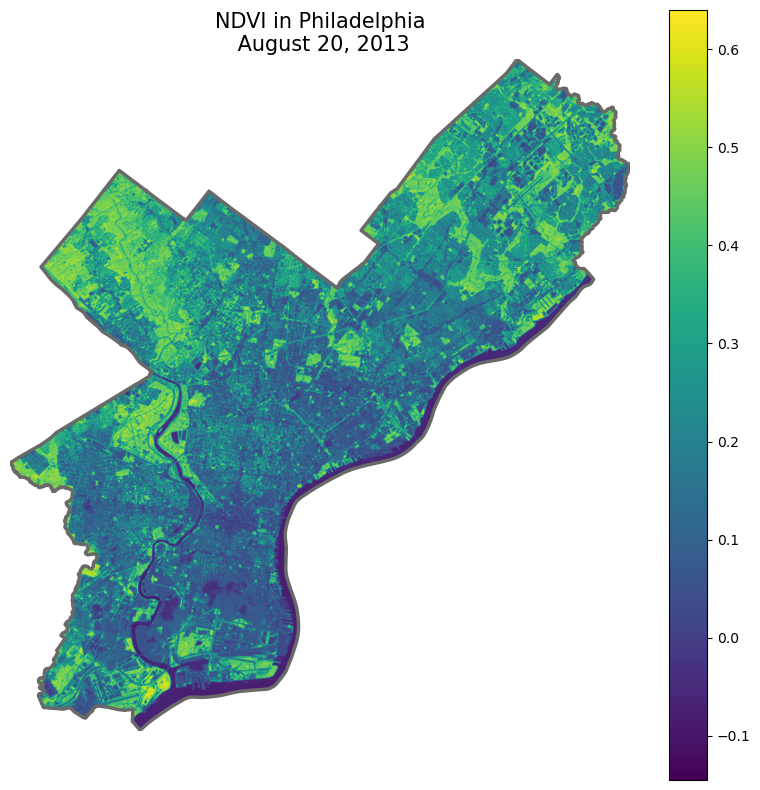

In [85]:
fig, ax = plt.subplots(figsize=(10,10))

# Plot NDVI
landsat_extent = [phl_ndvi_rio.bounds.left, phl_ndvi_rio.bounds.right, phl_ndvi_rio.bounds.bottom, phl_ndvi_rio.bounds.top]
# [red.bounds.left, red.bounds.right, red.bounds.bottom, red.bounds.top]
img = ax.imshow(phl_ndvi_aug[0], extent=landsat_extent) #ndvi, red.read(1), phl_ndvi[0]

# Format and plot city limits
city_limits.plot(ax = ax, edgecolor="dimgray", facecolor="none", linewidth=2.5)
plt.colorbar(img)
ax.set_axis_off()
ax.set_title("NDVI in Philadelphia\n August 20, 2013", fontsize=15)

In [86]:
# fig.savefig("Graphs/phl_ndvi_aug_2013.pdf")
# phl_ndvi_sep_2018
# phl_ndvi_aug_2013

##### Statistics

In [12]:
sep_stats = zonal_stats(phl_census_32618, "Images/phl_ndvi_sep_2018.tif", stats=['mean', 'median'])
# sep_stats == zonal_stats(phl_census_32618, "Images/phl_ndvi_sep_2018.tif", 
#                          affine=phl_ndvi_rio_sep.transform, stats=['mean', 'median'])
# True

In [112]:
aug_stats = zonal_stats(phl_census_32618, "Images/phl_ndvi_aug_2013.tif", affine=phl_ndvi_rio_aug.transform, 
                        stats=['mean', 'median'])

In [14]:
phl_census_ndvi = phl_census_32618
phl_census_ndvi["sep_mean_ndvi"] = [s["mean"] for s in sep_stats]
phl_census_ndvi["sep_median_ndvi"] = [s["median"] for s in sep_stats]

In [115]:
#phl_census_ndvi_sep = phl_census_32618

In [114]:
#phl_census_ndvi_aug = phl_census_32618
phl_census_ndvi_aug["aug_mean_ndvi"] = [s["mean"] for s in aug_stats]
phl_census_ndvi_aug["aug_median_ndvi"] = [s["median"] for s in aug_stats]

In [15]:
alt.Chart(phl_census_ndvi.to_crs(4326)).mark_geoshape(stroke="gray").encode(tooltip=["sep_mean_ndvi:Q", "sep_median_ndvi:Q",
                                                                                    "NAMELSAD10:N"],
                                                                color=alt.Color("sep_mean_ndvi:Q", 
                                                                                scale=alt.Scale(scheme="viridis")),
                                                               ).properties(width=500, height=500)

alt.Chart(...)

In [118]:
alt.Chart(phl_census_ndvi.to_crs(4326)).mark_geoshape(stroke="gray").encode(tooltip=["aug_mean_ndvi:Q", "aug_median_ndvi:Q",
                                                                                    "NAMELSAD10:N"],
                                                                color=alt.Color("aug_mean_ndvi:Q", 
                                                                                scale=alt.Scale(scheme="viridis")),
                                                               ).properties(width=500, height=500)

alt.Chart(...)

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):
C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


Text(0.5, 0.98, "Mean NDVI in Philadelphia's Census Blocks")

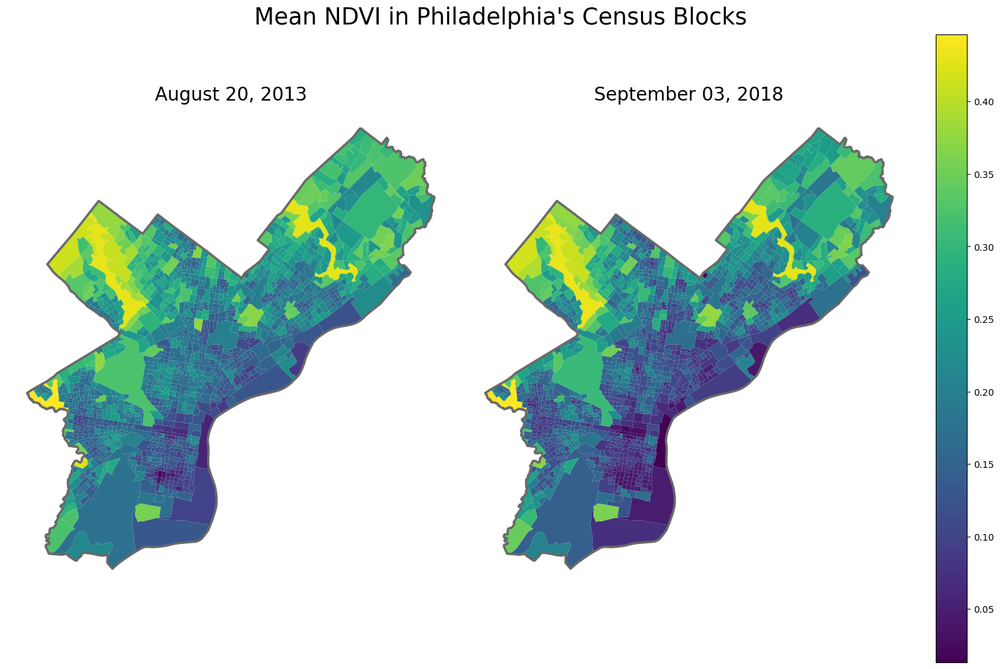

In [162]:
fig_phl, ax_phl = plt.subplots(figsize=(15,10), nrows=1, ncols=2, layout="constrained")

# Plot NDVI regions
phl_census_ndvi.plot("sep_mean_ndvi", ax = ax_phl[1], cmap = "viridis", label="Sep", legend=True)
ax_phl[1].set_title("September 03, 2018", fontsize=20)
phl_census_ndvi.plot("aug_mean_ndvi", ax = ax_phl[0], cmap = "viridis", label="Aug")
ax_phl[0].set_title("August 20, 2013", fontsize=20)


# Format and plot city limits
for i in range(2):
    #phl_census_32618.plot(ax=ax_phl[i], edgecolor="white", facecolor="none", linewidth=0.001)
    city_limits.plot(ax=ax_phl[i], edgecolor="dimgray", facecolor="none", linewidth=2.5)
    ax_phl[i].set_axis_off()
    
fig_phl.suptitle("Mean NDVI in Philadelphia's Census Block Groups", fontsize=25)

In [163]:
fig_phl.savefig("Graphs/phl_ndvi_mean_aug_13_sep_18.pdf")

In [185]:
mean_dif = np.mean(phl_census_ndvi["sep_mean_ndvi"]-phl_census_ndvi["aug_mean_ndvi"])
stdev = np.std(phl_census_ndvi["sep_mean_ndvi"]-phl_census_ndvi["aug_mean_ndvi"], ddof=1)
n = len(phl_census_ndvi["sep_mean_ndvi"]-phl_census_ndvi["aug_mean_ndvi"])
stdev

0.01892328686514147

In [188]:
mean_dif + 1.96*stdev/np.sqrt(len(phl_census_ndvi["sep_mean_ndvi"]-phl_census_ndvi["aug_mean_ndvi"]))

-0.015131077414490438

#### Temperature

In [12]:
folder = "Landsat/B10"
file = "20130820_20200913"
# "20180903_20200831"
# "20130820_20200913"

In [13]:
temp_file = f"Data/{folder}/LC08_L1TP_014032_{file}_02_T1_B10.TIF"
# "Data/landsat_june/band_10/LC08_L2SP_014032_20130601_20200912_02_T1_ST_B10.tif"

In [14]:
band_10 = rio.open(temp_file)
band_10

<open DatasetReader name='Data/Landsat/B10/LC08_L1TP_014032_20130820_20200913_02_T1_B10.TIF' mode='r'>

In [60]:
band_10.meta

{'driver': 'GTiff',
 'dtype': 'uint16',
 'nodata': 0.0,
 'width': 7741,
 'height': 7871,
 'count': 1,
 'crs': CRS.from_epsg(32618),
 'transform': Affine(30.0, 0.0, 395085.0,
        0.0, -30.0, 4582215.0)}

In [15]:
temp_phl, temp_transform = mask(dataset=band_10, shapes=city_limits.geometry,
    crop=True,  # remove pixels not within boundary
    all_touched=True,  # get all pixels that touch the boudnary
    filled=False,  # do not fill cropped pixels with a default value
)

In [4]:
def lst(band, NDVI, celsius = False):
    """
    Calculate land surface temperature of Landsat 8 using band 10 Level 1 collection
    
    temp = BT/1 + w * (BT /p) * ln(e)
    
    BT = At Satellite temperature (brightness)
    w = wavelength of emitted radiance (μm)
    
    where p = h * c / s (1.439e-2 mK)
    
    h = Planck's constant (Js)
    s = Boltzmann constant (J/K)
    c = velocity of light (m/s)
    
    """
    toa = 3.342e-4 * band + 0.1 - 0.29
    
    k_1 = 774.8853 # 1321.08
    k_2 = 1321.0789 # 777.89
    
    bt = k_2 / np.log((k_1 / toa) + 1) # Kelvin
    
    # bt = (9 * (bt-273.15) / 5) + 32 # Fahrenheit
    
    veg_prop = ((NDVI - NDVI.min()) / (NDVI.max() - NDVI.min())) ** 2
    
    emissivity = 0.004 * veg_prop + 0.986
    
    h = 6.626e-34
    s = 1.38e-23
    c = 2.998e8

    p = h * c / s
    
    wavelength = 10.895e-6 #0.0010895

    lst = bt / (1 + ((wavelength * bt / p) * np.log(emissivity)))
    
    lst = (9 * (lst-273.15) / 5) + 32
    return lst

In [ ]:
temp = lst(band_10.read(1).astype("float"), ndvi_rio.read(1).astype("float"))

In [24]:
temp = (9*(temp_phl*0.00341802 + 149 - 273.15) / 5) + 32

Text(0.5, 1.0, 'LST in Philadelphia\n July 2020')

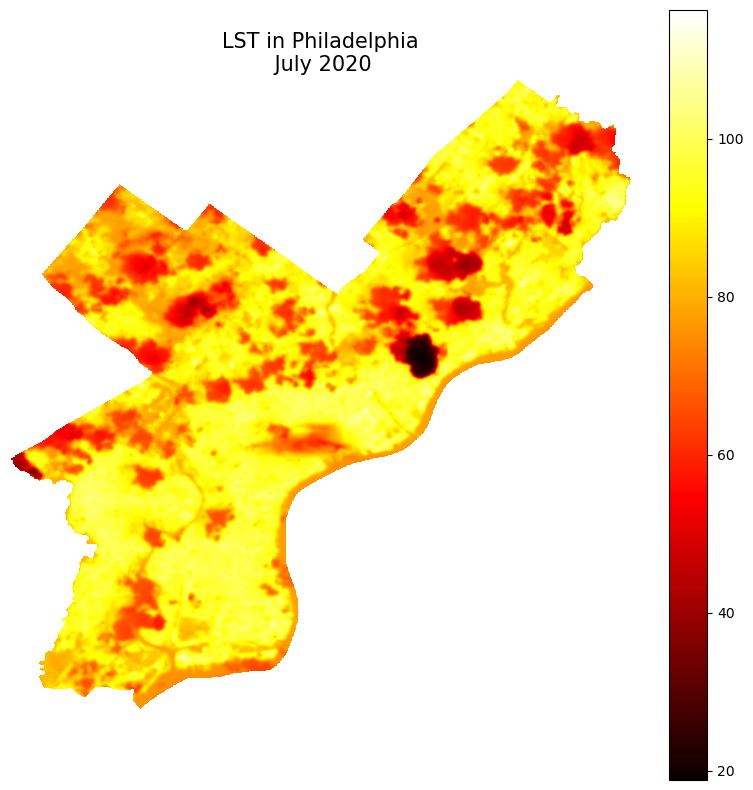

In [55]:
fig, ax = plt.subplots(figsize=(10,10))

# Plot NDVI
landsat_extent = [band_10.bounds.left, band_10.bounds.right, band_10.bounds.bottom, band_10.bounds.top]
img = ax.imshow(temp[0], extent=landsat_extent, cmap="hot")

# Format and plot city limits
#city_limits.plot(ax = ax, edgecolor="gray", facecolor="none", linewidth=2.5)
plt.colorbar(img)
ax.set_axis_off()
ax.set_title("LST in Philadelphia\n July 2020", fontsize=15)

In [19]:
surftemp = rxr.open_rasterio(temp_file).astype("float")
surftemp.sel(band=1)

<xarray.DataArray (y: 7871, x: 7741)>
[60929411 values with dtype=uint16]
Coordinates:
    band         int32 1
  * x            (x) float64 3.933e+05 3.933e+05 ... 6.255e+05 6.255e+05
  * y            (y) float64 4.582e+06 4.582e+06 ... 4.346e+06 4.346e+06
    spatial_ref  int32 0
Attributes:
    AREA_OR_POINT:  Point
    _FillValue:     0
    scale_factor:   1.0
    add_offset:     0.0

In [8]:
file_name = "ndvi_aug_2013"
ndvi_xarray = rxr.open_rasterio(f"Images/{file_name}.tif")
ndvi_xarray.sel(band=1)

<xarray.DataArray (y: 7871, x: 7741)>
[60929411 values with dtype=float64]
Coordinates:
    band         int32 1
  * x            (x) float64 3.933e+05 3.933e+05 ... 6.255e+05 6.255e+05
  * y            (y) float64 4.582e+06 4.582e+06 ... 4.346e+06 4.346e+06
    spatial_ref  int32 0
Attributes:
    AREA_OR_POINT:  Area
    scale_factor:   1.0
    add_offset:     0.0

In [20]:
xmin, ymin, xmax, ymax = city_limits.total_bounds
phl_temp = surftemp.sel(x=slice(xmin, xmax), y=slice(ymax, ymin)) # NOTE: y-coord system is in descending order!
phl_temp.compute()

<xarray.DataArray (band: 1, y: 1000, x: 924)>
array([[[28158, 28097, 28040, ..., 30399, 30691, 30981],
        [28044, 27980, 27940, ..., 30377, 30657, 30910],
        [27989, 27953, 27915, ..., 30398, 30689, 30916],
        ...,
        [29223, 29140, 28848, ..., 28864, 28965, 29042],
        [29198, 29092, 28760, ..., 28974, 29068, 29129],
        [29165, 28996, 28625, ..., 29076, 29154, 29231]]], dtype=uint16)
Coordinates:
  * band         (band) int32 1
  * x            (x) float64 4.761e+05 4.761e+05 ... 5.037e+05 5.038e+05
  * y            (y) float64 4.443e+06 4.443e+06 ... 4.413e+06 4.413e+06
    spatial_ref  int32 0
Attributes:
    AREA_OR_POINT:  Point
    _FillValue:     0
    scale_factor:   1.0
    add_offset:     0.0

In [9]:
phl_ndvi = ndvi_xarray.sel(x=slice(xmin, xmax), y=slice(ymax, ymin))
phl_ndvi.compute()

<xarray.DataArray (band: 1, y: 1000, x: 924)>
array([[[0.3554321 , 0.35357744, 0.43817323, ..., 0.10432925,
         0.11597222, 0.16774976],
        [0.35467359, 0.33489801, 0.4326908 , ..., 0.05947272,
         0.08852727, 0.10876358],
        [0.38009263, 0.39264784, 0.42746309, ..., 0.15473509,
         0.08753967, 0.05575088],
        ...,
        [0.32082646, 0.24867725, 0.26834412, ..., 0.33100822,
         0.22440572, 0.22728858],
        [0.24283104, 0.19899165, 0.31487553, ..., 0.23145305,
         0.23232908, 0.22520669],
        [0.34933008, 0.28969486, 0.35251244, ..., 0.28286219,
         0.28398981, 0.18115139]]])
Coordinates:
  * band         (band) int32 1
  * x            (x) float64 4.761e+05 4.761e+05 ... 5.037e+05 5.038e+05
  * y            (y) float64 4.443e+06 4.443e+06 ... 4.413e+06 4.413e+06
    spatial_ref  int32 0
Attributes:
    AREA_OR_POINT:  Area
    scale_factor:   1.0
    add_offset:     0.0

In [95]:
aug_temp.close()

In [12]:
phl_temp_aug = lst(phl_temp.sel(band=1), phl_ndvi.sel(band=1))
phl_temp_aug.rio.to_raster("Images/phl_temp_aug_2013.tif")

In [21]:
# Update
test_ndvi = rxr.open_rasterio("Images/NDVI/phl_ndvi_20130820.tif")
phl_temp_aug = lst(phl_temp.sel(band=1), test_ndvi.sel(band=1))
phl_temp_aug.rio.to_raster("Images/phl_temp_aug_2013_new.tif")

In [81]:
sep_temp.close()
phl_temp_sep = lst(phl_temp.sel(band=1), phl_ndvi.sel(band=1))
phl_temp_sep.rio.to_raster("Images/phl_temp_sep_2018.tif")

Text(0.5, 1.0, 'LST in Philadelphia\n Year: Aug 20, 2013')

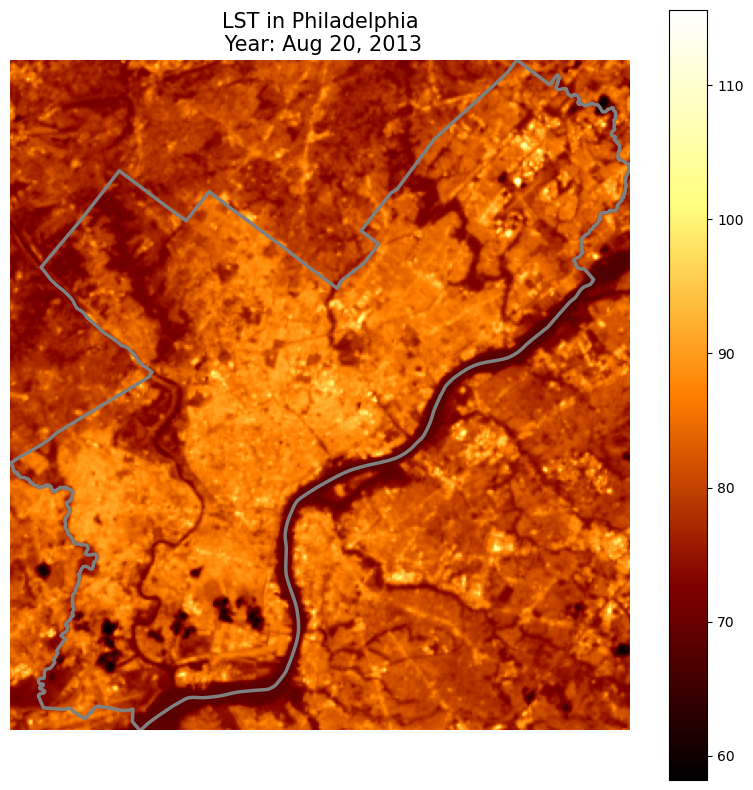

In [32]:
fig, ax = plt.subplots(figsize=(10,10))

landsat_extent = [band_10.bounds.left, band_10.bounds.right, band_10.bounds.bottom, band_10.bounds.top]
# img = ax.imshow(phl_temp[0], extent=landsat_extent, cmap="hot")
phl_temp_aug.plot(cmap="afmhot")
# Format and plot city limits
city_limits.plot(ax = ax, edgecolor="gray", facecolor="none", linewidth=2.5)
# plt.colorbar(img)
ax.set_axis_off()
ax.set_title("LST in Philadelphia\n Year: Aug 20, 2013", fontsize=15)

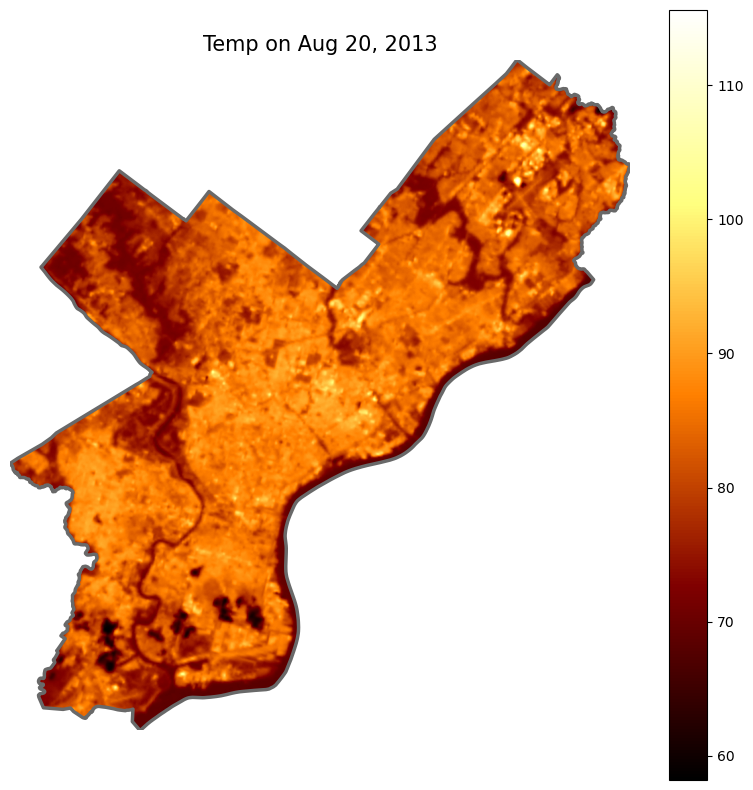

In [44]:
temp_fig, temp_ax = geo_plot(rio.open("Images/phl_temp_aug_2013_new.tif"), city_limits, "Temp on Aug 20, 2013", "afmhot")

In [29]:
aug_temp = rio.open("Images/phl_temp_aug_2013.tif")
sep_temp = rio.open("Images/phl_temp_sep_2018.tif")

In [25]:
temp_stats_aug = zonal_stats(phl_census_32618, "Images/phl_temp_aug_2013_new.tif", affine=aug_temp.transform, 
                             stats=["mean", "median"])

In [7]:
temp_stats_sep = zonal_stats(phl_census_32618, "Images/phl_temp_sep_2018.tif", affine=sep_temp.transform, 
                             stats=["mean", "median"])

In [137]:
stats[0]["mean"] == stats_1[0]["mean"] 

True

In [26]:
phl_census_temp = phl_census_32618
phl_census_temp["aug_mean_temp"] = [s["mean"] for s in temp_stats_aug]
phl_census_temp["aug_median_temp"] = [s["median"] for s in temp_stats_aug]

In [8]:
phl_census_temp["sep_mean_temp"] = [s["mean"] for s in temp_stats_sep]
phl_census_temp["sep_median_temp"] = [s["median"] for s in temp_stats_sep]

In [10]:
alt.Chart(phl_census_temp.to_crs(4326)).mark_geoshape(stroke="gray").encode(tooltip=["aug_mean_temp:Q", "aug_median_temp:Q",
                                                                                    "NAMELSAD10:N"],
                                                                color=alt.Color("aug_mean_temp:Q", 
                                                                                scale=alt.Scale(scheme="inferno")),
                                                               ).properties(width=500, height=500)

alt.Chart(...)

In [27]:
alt.Chart(phl_census_temp.to_crs(4326)).mark_geoshape(stroke="gray").encode(tooltip=["aug_mean_temp:Q", "aug_median_temp:Q",
                                                                                    "NAMELSAD10:N"],
                                                                color=alt.Color("aug_mean_temp:Q", 
                                                                                scale=alt.Scale(scheme="inferno")),
                                                               ).properties(width=500, height=500)

alt.Chart(...)

In [11]:
alt.Chart(phl_census_temp.to_crs(4326)).mark_geoshape(stroke="gray").encode(tooltip=["sep_mean_temp:Q", "sep_median_temp:Q",
                                                                                    "NAMELSAD10:N"],
                                                                color=alt.Color("sep_mean_temp:Q", 
                                                                                scale=alt.Scale(scheme="inferno")),
                                                               ).properties(width=500, height=500)

alt.Chart(...)

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):
C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


Text(0.5, 0.98, "Mean LST in Philadelphia's Census Blocks")

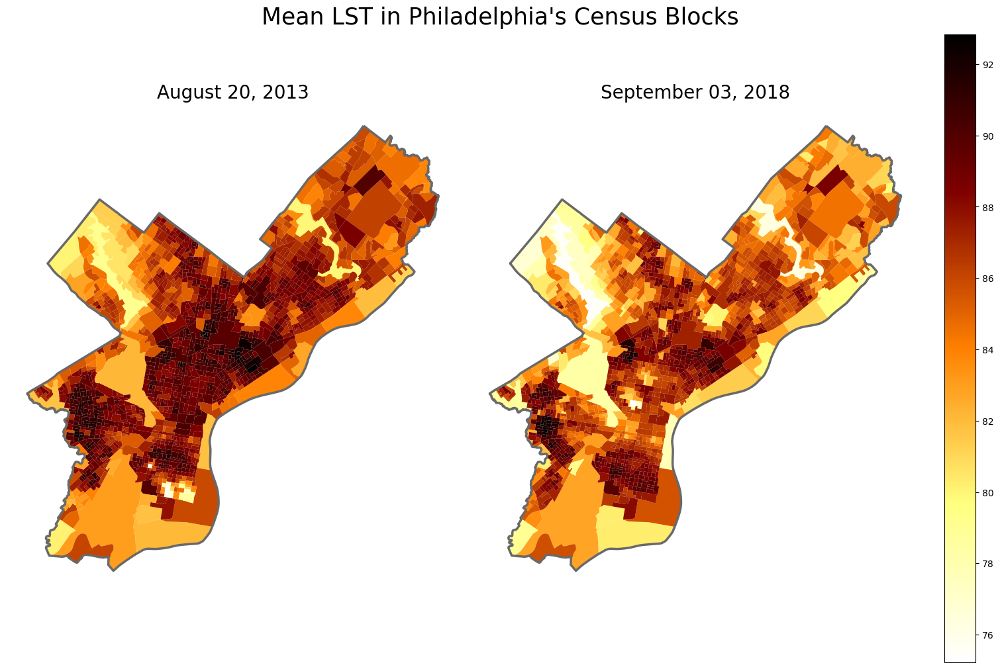

In [9]:
fig_phl_temp, ax_phl_temp = plt.subplots(figsize=(15,10), nrows=1, ncols=2, layout="constrained")

# Plot NDVI regions
phl_census_temp.plot("sep_mean_temp", ax = ax_phl_temp[1], cmap = "afmhot_r", label="Sep", legend=True)
ax_phl_temp[1].set_title("September 03, 2018", fontsize=20)
phl_census_temp.plot("aug_mean_temp", ax = ax_phl_temp[0], cmap = "afmhot_r", label="Aug")
ax_phl_temp[0].set_title("August 20, 2013", fontsize=20)

# Format and plot city limits
for i in range(2):
    #phl_census_32618.plot(ax=ax_phl[i], edgecolor="white", facecolor="none", linewidth=0.001)
    city_limits.plot(ax=ax_phl_temp[i], edgecolor="dimgray", facecolor="none", linewidth=2.5)
    ax_phl_temp[i].set_axis_off()
     
fig_phl_temp.suptitle("Mean LST in Philadelphia's Census Block Groups", fontsize=25)

In [12]:
fig_phl_temp.savefig("Graphs/phl_temp_mean_aug_13_sep_18.pdf")

In [18]:
mean_dif_temp = np.mean(phl_census_temp["sep_mean_temp"]-phl_census_temp["aug_mean_temp"])
stdev_temp = np.std(phl_census_temp["sep_mean_temp"]-phl_census_temp["aug_mean_temp"], ddof=1)
n = len(phl_census_temp["sep_mean_temp"]-phl_census_temp["aug_mean_temp"])
mean_dif_temp

-5.0329558723376575

In [72]:
print(mean_dif_temp + 1.96*stdev_temp/np.sqrt(n))
print(mean_dif_temp - 1.96*stdev_temp/np.sqrt(n))

-4.863812086794696
-5.202099657880619


In [20]:
np.mean(phl_census_temp["aug_mean_temp"])

91.46830031023379

## Test Code

In [35]:
red_file = "Data/Landsat/B4/LC08_L1TP_014032_20130820_20200913_02_T1_B4.TIF"
# "Data/landsat_june/band_4/LC08_L2SP_014032_20130601_20200912_02_T1_SR_B4.tif"
nir_file = "Data/Landsat/B5/LC08_L1TP_014032_20130820_20200913_02_T1_B5.TIF"
# "Data/landsat_june/band_5/LC08_L2SP_014032_20130601_20200912_02_T1_SR_B5.tif"
temp_file = "Data/Landsat/B10/LC08_L1TP_014032_20130820_20200913_02_T1_B10.tif"
# "Data/landsat_june/band_10/LC08_L2SP_014032_20130601_20200912_02_T1_ST_B10.tif"

In [36]:
aug_landsat = landsat_processing(data = [red_file, nir_file, temp_file], bands = [4,5,10], bounds = city_limits)

In [43]:
jul_landsat = landsat_processing(data = [red, nir, temp_file], bands = [4,5,10], bounds = city_limits)

In [75]:
aug_landsat

<xarray.DataArray (band: 3, y: 1000, x: 924)>
array([[[ 9237,  8222,  7923, ...,  9594,  9432, 10185],
        [ 9025,  7959,  7477, ...,  9392,  9127,  9380],
        [ 8307,  7526,  7335, ...,  8782,  9284,  9724],
        ...,
        [ 9609, 10301, 10205, ...,  8322,  9287,  9841],
        [10885,  9771,  8667, ...,  8358,  9545, 10047],
        [ 9071,  9621,  8232, ...,  7842,  8578,  9604]],

       [[18842, 18277, 19311, ..., 10853, 11613, 14236],
        [17756, 17654, 18808, ..., 10617, 11357, 11832],
        [17914, 17318, 19107, ..., 11907, 10959, 10999],
        ...,
        [18501, 17622, 17779, ..., 16668, 15287, 16322],
        [16763, 15563, 16901, ..., 14234, 14544, 15276],
        [18043, 18141, 18754, ..., 14568, 15376, 13995]],

       [[28044, 27952, 27843, ..., 31547, 31528, 31500],
        [27891, 27832, 27784, ..., 31539, 31548, 31532],
        [27777, 27801, 27820, ..., 31475, 31514, 31517],
        ...,
        [29453, 29144, 28678, ..., 28791, 29095, 29397],
        [29422, 29091, 28624, ..., 29087, 29300, 29496],
        [29373, 29015, 28561, ..., 29432, 29564, 29624]]], dtype=uint16)
Coordinates:
  * band         (band) int32 4 5 10
  * x            (x) float64 4.761e+05 4.761e+05 ... 5.037e+05 5.038e+05
  * y            (y) float64 4.443e+06 4.443e+06 ... 4.413e+06 4.413e+06
    spatial_ref  int32 0
Attributes:
    AREA_OR_POINT:  Point
    _FillValue:     0
    scale_factor:   1.0
    add_offset:     0.0

### NDVI

In [37]:
ndvi = veg_index(aug_landsat)

In [44]:
red_band = jul_landsat.sel(band=4)
nir_band = jul_landsat.sel(band=5)

# Calculate the NDVI
ndvi_band = (nir_band - red_band) / (nir_band + red_band)

In [64]:
(aug_landsat.sel(band =4) - aug_landsat.sel(band =5)).min()

<xarray.DataArray ()>
array(0, dtype=uint16)
Coordinates:
    spatial_ref  int32 0

In [36]:
p = phl_ndvi.hvplot.image(
    x="x",
    y="y",
    geo=True,
    crs=32618,
    datashade=True, # NEW: USE DATASHADER
    project=True, # NEW: PROJECT THE DATA BEFORE PLOTTING
    frame_height=500,
    frame_width=500,
    cmap="viridis",
    title = "NDVI"
)

p_hover = phl_ndvi.hvplot(
    x="x",
    y="y",
    crs=32618,
    geo=True,
    rasterize=True,
    frame_height=500,
    frame_width=500,
    alpha=0, # SET ALPHA=0 TO MAKE THIS TRANSPARENT
    colorbar=False,
)

p * p_hover

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\osgeo\osr.py:385: FutureWarning: Neither osr.UseExceptions() nor osr.DontUseExceptions() has been explicitly called. In GDAL 4.0, exceptions will be enabled by default.
  warnings.warn(


:DynamicMap   [band]
   :Overlay
      .RGB.I   :RGB   [x,y]   (R,G,B,A)
      .Image.I :Image   [x,y]   (value)

In [21]:
limits_plot = phl_block_group.to_crs(32618).hvplot.polygons(
    geo=True, crs=32618, line_color="black", line_width=2, alpha=0, line_alpha=1, frame_height=500,
    frame_width=500,
)
limits_plot # Originally city limits

:Polygons   [Longitude,Latitude]

Text(0.5, 1.0, 'NDVI in Philadelphia\n Aug. 7, 2014')

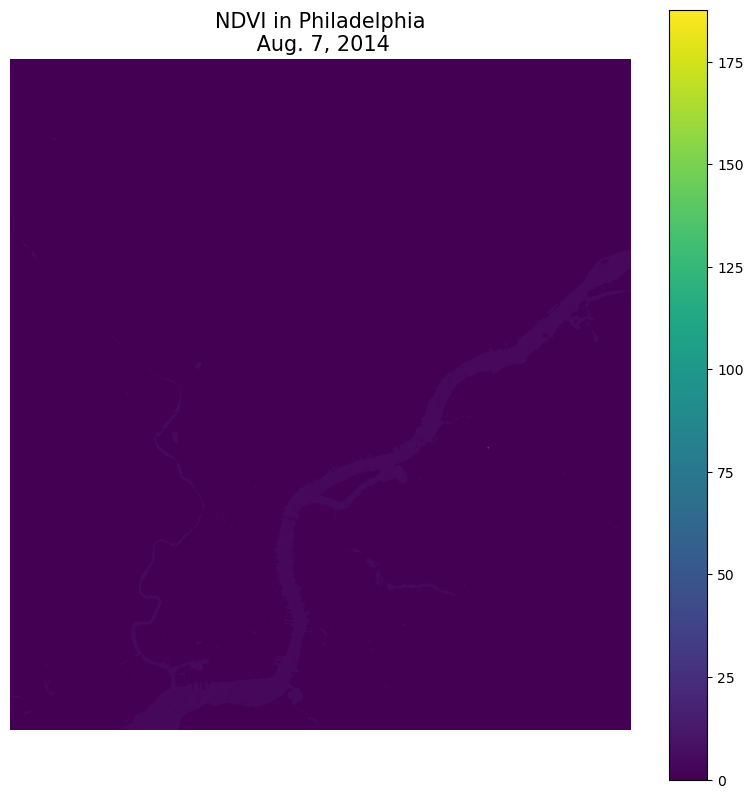

In [80]:
fig, ax = plt.subplots(figsize=(10,10))

# Plot NDVI
# landsat_extent = [ndvi.bounds.left, ndvi.bounds.right, ndvi.bounds.bottom, ndvi.bounds.top]
img = ax.imshow(ndvi) # extent=landsat_extent

# Format and plot city limits
# city_limits.plot(ax = ax, edgecolor="gray", facecolor="none", linewidth=2.5)
plt.colorbar(img)
ax.set_axis_off()
ax.set_title("NDVI in Philadelphia\n Aug. 7, 2014", fontsize=15)

### Temperature

In [99]:
aug_temp = land_surface_temp(aug_landsat, ndvi, celsius = False)

In [57]:
jul_temp = land_surface_temp(jul_landsat, ndvi_band, celsius = False)

In [39]:
plot_10 = phl_temp_aug.hvplot.image(
    x="x",
    y="y",
    rasterize=True,
    cmap="fire_r",
    crs=32618,
    geo=True,
    frame_height=400,
    frame_width=400,
    title="Band 10",
)
plot_10

:DynamicMap   []
   :Image   [x,y]   (value)

In [41]:
plot_10 = phl_temp_aug.hvplot.image(
    x="x",
    y="y",
    rasterize=True,
    cmap="fire_r",
    crs=32618,
    geo=True,
    frame_height=400,
    frame_width=400,
    title="Band 10",
)
plot_10

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\osgeo\osr.py:385: FutureWarning: Neither osr.UseExceptions() nor osr.DontUseExceptions() has been explicitly called. In GDAL 4.0, exceptions will be enabled by default.
  warnings.warn(


:DynamicMap   []
   :Image   [x,y]   (value)

In [101]:
plot_10 = aug_temp.hvplot.image(
    x="x",
    y="y",
    rasterize=True,
    cmap="fire_r",
    crs=32618,
    geo=True,
    frame_height=400,
    frame_width=400,
    title="Band 10",
)
plot_10

:DynamicMap   []
   :Image   [x,y]   (value)

#### New Code

In [7]:
tempfile = "Data/Landsat/B10/LC08_L1TP_014032_20140807_20200911_02_T1_B10.tif"
ndvifile = "Images/NDVI/ndvi_20140807.tif"

In [8]:
temp_tif(tempfile, ndvifile, "Images/phl_temp_aug_2014_test", boundary=city_limits)

In [34]:
aug_temp = rio.open("Images/phl_temp_aug_2013_test.tif")
temp_stats_aug = zonal_stats(phl_census_32618, "Images/phl_temp_aug_2013_test.tif", affine=aug_temp.transform, 
                             stats=["mean", "median"])

In [35]:
phl_census_temp = gpd.GeoDataFrame(phl_census_32618)
phl_census_temp["aug_mean_temp"] = [s["mean"] for s in temp_stats_aug]
phl_census_temp["aug_median_temp"] = [s["median"] for s in temp_stats_aug]

In [36]:
alt.Chart(phl_census_temp.to_crs(4326)).mark_geoshape(stroke="gray").encode(tooltip=["aug_mean_temp:Q", "aug_median_temp:Q",
                                                                                    "NAMELSAD10:N"],
                                                                color=alt.Color("aug_mean_temp:Q", 
                                                                                scale=alt.Scale(scheme="inferno")),
                                                               ).properties(width=500, height=500)

alt.Chart(...)

In [15]:
alt.Chart(phl_census_temp.to_crs(4326)).mark_geoshape(stroke="gray").encode(tooltip=["aug_mean_temp:Q", "aug_median_temp:Q",
                                                                                    "NAMELSAD10:N"],
                                                                color=alt.Color("aug_mean_temp:Q", 
                                                                                scale=alt.Scale(scheme="inferno")),
                                                               ).properties(width=500, height=500)

alt.Chart(...)

In [24]:
aug_temp.close()

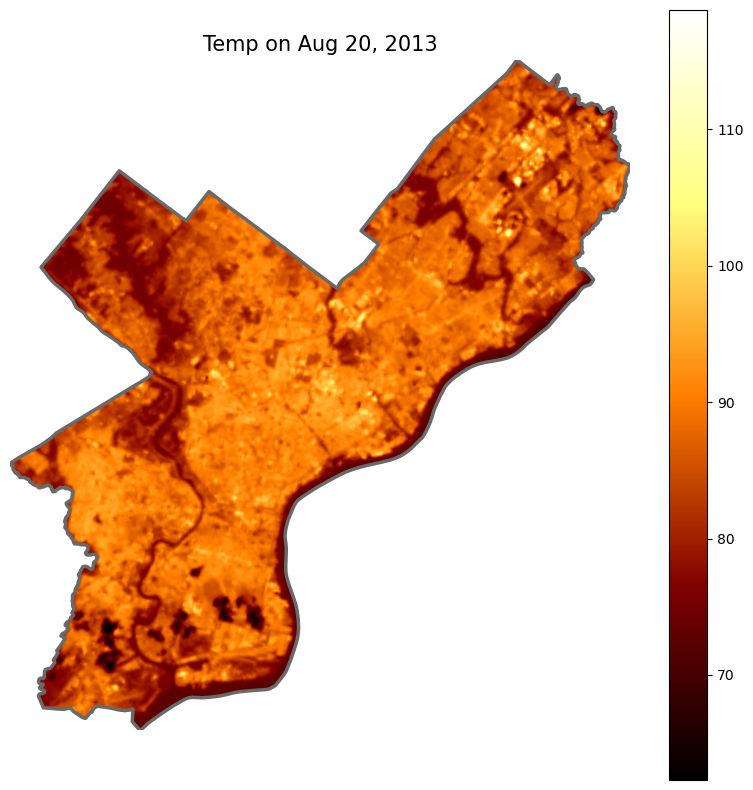

In [33]:
temp_fig, temp_ax = geo_plot(rio.open("Images/phl_temp_aug_2013_test.tif"), city_limits, "Temp on Aug 20, 2013", "afmhot")

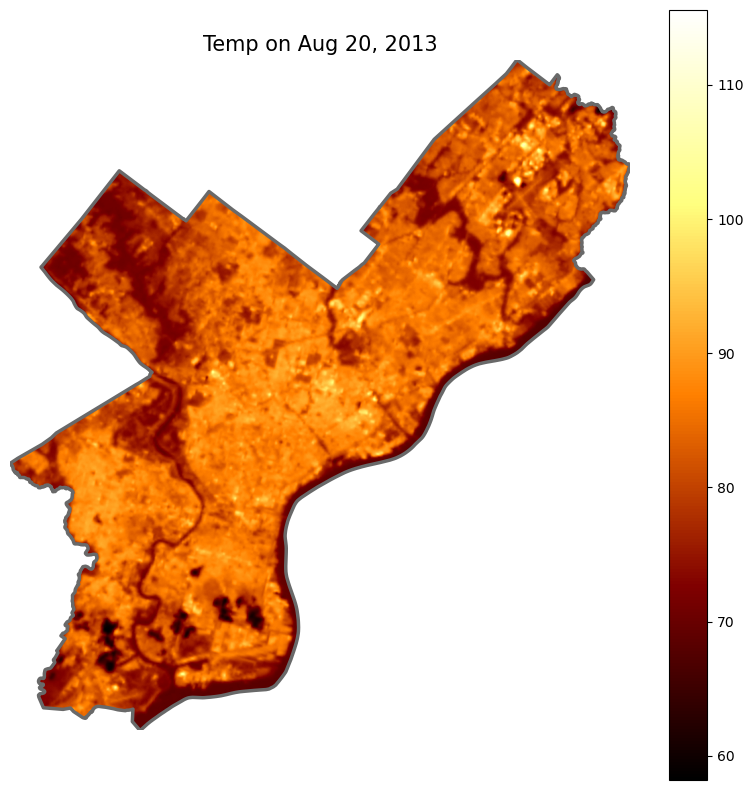

In [16]:
temp_fig, temp_ax = geo_plot(rio.open("Images/phl_temp_aug_2013_test.tif"), city_limits, "Temp on Aug 20, 2013", "afmhot")

In [5]:
# Check Hamil
city_stats = stats(city_limits, "Images/Temp/phl_b10_temp_20140807.tif")
city_stats

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\rasterstats\io.py:328: NodataWarning: Setting nodata to -999; specify nodata explicitly
  warnings.warn(


,OBJECTID,Shape__Area,Shape__Length,geometry,median,mean,std,min,max
0,1,3.970706e+09,394751.12047,"POLYGON ((498724.960 4443066.927, 498759.458 4...",86.901775,85.668343,5.907629,60.698882,116.8137


In [11]:
city_stats = zonal_stats(city_limits, "Images/phl_temp_aug_2014_test.tif")
city_stats

[{'min': 56.56942754314679,
  'max': 113.6164538821465,
  'mean': 82.01580732217984,
  'count': 409557}]

In [20]:
city_stats[0].mean

AttributeError: 'dict' object has no attribute 'mean'

In [10]:
city_stats = stats(city_limits, "Images/NDVI/phl_ndvi_20140807.tif")
city_stats

,OBJECTID,Shape__Area,Shape__Length,geometry,median,mean,std,min,max
0,1,3.970706e+09,394751.12047,"POLYGON ((498724.960 4443066.927, 498759.458 4...",0.210399,0.229671,0.154412,-0.157384,0.641267


### Pysal